# Sentiment Analysis using News Headlines for Stock Prediction

##1. Business Understanding




This study is focused on applying sentiment analysis on news headlines extracted from Reddit news to predict stock market performance. The idea is to create two time series one by using emotions extracted from news headlines and the other by using stock market performance over the same duration. Next, the relationship between the two timeseries is analyzed by using algorithms such as ARIMA, SARIMAX, LSTM and LSTM with news emotion to find if the two timeseries are causal, and then future stock market performance is predicted based on the analysis.                    

---
The goals are 

*   To find if the there is any relationship between emotion from news and stock performance.
*   To forecast future stock performance.




###Loading Libraries

In [ ]:
#Loading Libraries
import pandas as pd
import re
!pip install vaderSentiment
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
!pip install text2emotion
import text2emotion as te
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dense

     |████████████████████████████████| 125 kB 36.4 MB/s 
     |████████████████████████████████| 57 kB 5.6 MB/s 
     |████████████████████████████████| 185 kB 18.3 MB/s 
  Created wheel for emoji: filename=emoji-1.5.0-py3-none-any.whl size=187457 sha256=bd848415c005ff918240edd9c9b0c0bb027137a2fd84138d10aa655da9a38197
  Stored in directory: /root/.cache/pip/wheels/db/b5/f6/b39abf14e94b3d6640613bbe630a66c10ccf7a12882d064fb5
Successfully built emoji
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


##2.  Data Understanding

### Data Collection

In [ ]:
#converting the data into pandas dataframe
df=pd.read_csv('/content/Combined_News_DJIA.csv',encoding = "ISO-8859-1")
df1=pd.read_csv('/content/upload_DJIA_table.csv',encoding = "ISO-8859-1")


In [ ]:
#Viewing the dataset
df.head()

,Date,Label,Top1,Top2,Top3,Top4,Top5,Top6,Top7,Top8,Top9,Top10,Top11,Top12,Top13,Top14,Top15,Top16,Top17,Top18,Top19,Top20,Top21,Top22,Top23,Top24,Top25
0,2008-08-08,0,"b""Georgia 'downs two Russian warplanes' as cou...",b'BREAKING: Musharraf to be impeached.',b'Russia Today: Columns of troops roll into So...,b'Russian tanks are moving towards the capital...,"b""Afghan children raped with 'impunity,' U.N. ...",b'150 Russian tanks have entered South Ossetia...,"b""Breaking: Georgia invades South Ossetia, Rus...","b""The 'enemy combatent' trials are nothing but...",b'Georgian troops retreat from S. Osettain cap...,b'Did the U.S. Prep Georgia for War with Russia?',b'Rice Gives Green Light for Israel to Attack ...,b'Announcing:Class Action Lawsuit on Behalf of...,"b""So---Russia and Georgia are at war and the N...","b""China tells Bush to stay out of other countr...",b'Did World War III start today?',b'Georgia Invades South Ossetia - if Russia ge...,b'Al-Qaeda Faces Islamist Backlash',"b'Condoleezza Rice: ""The US would not act to p...",b'This is a busy day: The European Union has ...,"b""Georgia will withdraw 1,000 soldiers from Ir...",b'Why the Pentagon Thinks Attacking Iran is a ...,b'Caucasus in crisis: Georgia invades South Os...,b'Indian shoe manufactory - And again in a se...,b'Visitors Suffering from Mental Illnesses Ban...,"b""No Help for Mexico's Kidnapping Surge"""
1,2008-08-11,1,b'Why wont America and Nato help us? If they w...,b'Bush puts foot down on Georgian conflict',"b""Jewish Georgian minister: Thanks to Israeli ...",b'Georgian army flees in disarray as Russians ...,"b""Olympic opening ceremony fireworks 'faked'""",b'What were the Mossad with fraudulent New Zea...,b'Russia angered by Israeli military sale to G...,b'An American citizen living in S.Ossetia blam...,b'Welcome To World War IV! Now In High Definit...,"b""Georgia's move, a mistake of monumental prop...",b'Russia presses deeper into Georgia; U.S. say...,b'Abhinav Bindra wins first ever Individual Ol...,b' U.S. ship heads for Arctic to define territ...,b'Drivers in a Jerusalem taxi station threaten...,b'The French Team is Stunned by Phelps and the...,b'Israel and the US behind the Georgian aggres...,"b'""Do not believe TV, neither Russian nor Geor...",b'Riots are still going on in Montreal (Canada...,b'China to overtake US as largest manufacturer',b'War in South Ossetia [PICS]',b'Israeli Physicians Group Condemns State Tort...,b' Russia has just beaten the United States ov...,b'Perhaps *the* question about the Georgia - R...,b'Russia is so much better at war',"b""So this is what it's come to: trading sex fo..."
2,2008-08-12,0,b'Remember that adorable 9-year-old who sang a...,"b""Russia 'ends Georgia operation'""","b'""If we had no sexual harassment we would hav...","b""Al-Qa'eda is losing support in Iraq because ...",b'Ceasefire in Georgia: Putin Outmaneuvers the...,b'Why Microsoft and Intel tried to kill the XO...,b'Stratfor: The Russo-Georgian War and the Bal...,"b""I'm Trying to Get a Sense of This Whole Geor...","b""The US military was surprised by the timing ...",b'U.S. Beats War Drum as Iran Dumps the Dollar',"b'Gorbachev: ""Georgian military attacked the S...",b'CNN use footage of Tskhinvali ruins to cover...,b'Beginning a war as the Olympics were opening...,b'55 pyramids as large as the Luxor stacked in...,b'The 11 Top Party Cities in the World',b'U.S. troops still in Georgia (did you know t...,b'Why Russias response to Georgia was right',"b'Gorbachev accuses U.S. of making a ""serious ...","b'Russia, Georgia, and NATO: Cold War Two'",b'Remember that adorable 62-year-old who led y...,b'War in Georgia: The Israeli connection',b'All signs point to the US encouraging Georgi...,b'Christopher King argues that the US and NATO...,b'America: The New Mexico?',"b""BBC NEWS | Asia-Pacific | Extinction 'by man..."
3,2008-08-13,0,b' U.S. refuses Israel weapons to attack Iran:...,"b""When the president ordered to attack Tskhinv...",b' Israel clears troops who k

In [ ]:
df1.head()

,Date,Open,High,Low,Close,Volume,Adj Close
0,2016-07-01,17924.240234,18002.380859,17916.910156,17949.369141,82160000,17949.369141
1,2016-06-30,17712.759766,17930.609375,17711.800781,17929.990234,133030000,17929.990234
2,2016-06-29,17456.019531,17704.509766,17456.019531,17694.679688,106380000,17694.679688
3,2016-06-28,17190.509766,17409.720703,17190.509766,17409.720703,112190000,17409.720703
4,2016-06-27,17355.210938,17355.210938,17063.080078,17140.240234,138740000,17140.240234


In [ ]:
df.shape 


(1989, 27)

In [ ]:
df1.shape

(1989, 7)

In [ ]:
#Checking missing data
df.isna().sum()


Date     0
Label    0
Top1     0
Top2     0
Top3     0
Top4     0
Top5     0
Top6     0
Top7     0
Top8     0
Top9     0
Top10    0
Top11    0
Top12    0
Top13    0
Top14    0
Top15    0
Top16    0
Top17    0
Top18    0
Top19    0
Top20    0
Top21    0
Top22    0
Top23    1
Top24    3
Top25    3
dtype: int64

There are few missing data but we will them ignore as news headlines for a day are combined and few missing values will not affect data modeling. 

In [ ]:
df1.isna().sum()

Date         0
Open         0
High         0
Low          0
Close        0
Volume       0
Adj Close    0
dtype: int64

In [ ]:
#checking duplicate values
df.duplicated().sum()

0

In [ ]:
df1.duplicated().sum()

0

##3.  Data Preparation

###Data Cleaning

In [ ]:
# Removing punctuations
data=df.iloc[:,2:27]
data.replace("[^a-zA-Z]"," ",regex=True, inplace=True)

# Renaming column names for ease of access
list1= [i for i in range(25)]
new_Index=[str(i) for i in list1]
data.columns= new_Index
data.head(5)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,b Georgia downs two Russian warplanes as cou...,b BREAKING Musharraf to be impeached,b Russia Today Columns of troops roll into So...,b Russian tanks are moving towards the capital...,b Afghan children raped with impunity U N ...,b Russian tanks have entered South Ossetia...,b Breaking Georgia invades South Ossetia Rus...,b The enemy combatent trials are nothing but...,b Georgian troops retreat from S Osettain cap...,b Did the U S Prep Georgia for War with Russia,b Rice Gives Green Light for Israel to Attack ...,b Announcing Class Action Lawsuit on Behalf of...,b So Russia and Georgia are at war and the N...,b China tells Bush to stay out of other countr...,b Did World War III start today,b Georgia Invades South Ossetia if Russia ge...,b Al Qaeda Faces Islamist Backlash,b Condoleezza Rice The US would not act to p...,b This is a busy day The European Union has ...,b Georgia will withdraw soldiers from Ir...,b Why the Pentagon Thinks Attacking Iran is a ...,b Caucasus in crisis Georgia invades South Os...,b Indian shoe manufactory And again in a se...,b Visitors Suffering from Mental Illnesses Ban...,b No Help for Mexico s Kidnapping Surge
1,b Why wont America and Nato help us If they w...,b Bush puts foot down on Georgian conflict,b Jewish Georgian minister Thanks to Israeli ...,b Georgian army flees in disarray as Russians ...,b Olympic opening ceremony fireworks faked,b What were the Mossad with fraudulent New Zea...,b Russia angered by Israeli military sale to G...,b An American citizen living in S Ossetia blam...,b Welcome To World War IV Now In High Definit...,b Georgia s move a mistake of monumental prop...,b Russia presses deeper into Georgia U S say...,b Abhinav Bindra wins first ever Individual Ol...,b U S ship heads for Arctic to define territ...,b Drivers in a Jerusalem taxi station threaten...,b The French Team is Stunned by Phelps and the...,b Israel and the US behind the Georgian aggres...,b Do not believe TV neither Russian nor Geor...,b Riots are still going on in Montreal Canada...,b China to overtake US as largest manufacturer,b War in South Ossetia PICS,b Israeli Physicians Group Condemns State Tort...,b Russia has just beaten the United States ov...,b Perhaps the question about the Georgia R...,b Russia is so much better at war,b So this is what it s come to trading sex fo...
2,b Remember that adorable year old who sang a...,b Russia ends Georgia operation,b If we had no sexual harassment we would hav...,b Al Qa eda is losing support in Iraq because ...,b Ceasefire in Georgia Putin Outmaneuvers the...,b Why Microsoft and Intel tried to kill the XO...,b Stratfor The Russo Georgian War and the Bal...,b I m Trying to Get a Sense of This Whole Geor...,b The US military was surprised by the timing ...,b U S Beats War Drum as Iran Dumps the Dollar,b Gorbachev Georgian military attacked the S...,b CNN use footage of Tskhinvali ruins to cover...,b Beginning a war as the Olympics were opening...,b pyramids as large as the Luxor stacked in...,b The Top Party Cities in the World,b U S troops still in Georgia did you know t...,b Why Russias response to Georgia was right,b Gorbachev accuses U S of making a serious ...,b Russia Georgia and NATO Cold War Two,b Remember that adorable year old who led y...,b War in Georgia The Israeli connection,b All signs point to the US encouraging Georgi...,b Christopher King argues that the US and NATO...,b America The New Mexico,b BBC NEWS Asia Pacific Extinction by man...
3,b U S refuses Israel weapons to attack Iran ...,b When the president ordered to attack Tskhinv...,b Israel clears troops who killed Reuters cam...,b Britain s policy of being tough on drugs is...,b Body of year old found in trunk Latest ...,b China has moved million quake survivors...,b Bush announces Operation Get All Up In Russi...,b Russian forces sink Georgian ships,b The commander of a Navy air reconnaissance s...,b of CNN readers Russia s ac

In [ ]:
# Convertng headlines to lower case
for index in new_Index:
    data[index]=data[index].str.lower()
data.head(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24
0,b georgia downs two russian warplanes as cou...,b breaking musharraf to be impeached,b russia today columns of troops roll into so...,b russian tanks are moving towards the capital...,b afghan children raped with impunity u n ...,b russian tanks have entered south ossetia...,b breaking georgia invades south ossetia rus...,b the enemy combatent trials are nothing but...,b georgian troops retreat from s osettain cap...,b did the u s prep georgia for war with russia,b rice gives green light for israel to attack ...,b announcing class action lawsuit on behalf of...,b so russia and georgia are at war and the n...,b china tells bush to stay out of other countr...,b did world war iii start today,b georgia invades south ossetia if russia ge...,b al qaeda faces islamist backlash,b condoleezza rice the us would not act to p...,b this is a busy day the european union has ...,b georgia will withdraw soldiers from ir...,b why the pentagon thinks attacking iran is a ...,b caucasus in crisis georgia invades south os...,b indian shoe manufactory and again in a se...,b visitors suffering from mental illnesses ban...,b no help for mexico s kidnapping surge


In [ ]:
#joining headlines for a single day
' '.join(str(x) for x in data.iloc[1,0:25])

'b why wont america and nato help us  if they wont help us now  why did we help them in iraq   b bush puts foot down on georgian conflict  b jewish georgian minister  thanks to israeli training  we re fending off russia   b georgian army flees in disarray as russians advance   gori abandoned to russia without a shot fired  b olympic opening ceremony fireworks  faked   b what were the mossad with fraudulent new zealand passports doing in iraq   b russia angered by israeli military sale to georgia  b an american citizen living in s ossetia blames u s  and georgian leaders for the genocide of innocent people  b welcome to world war iv  now in high definition   b georgia s move  a mistake of monumental proportions   b russia presses deeper into georgia  u s  says regime change is goal  b abhinav bindra wins first ever individual olympic gold medal for india  b  u s  ship heads for arctic to define territory  b drivers in a jerusalem taxi station threaten to quit rather than work for their 

In [ ]:
#creating a list of headlines
headlines = []
for row in range(0, len(data.index)):
    headlines.append(' '.join(str(x) for x in data.iloc[row,0:25]))

headlines

['b georgia  downs two russian warplanes  as countries move to brink of war  b breaking  musharraf to be impeached   b russia today  columns of troops roll into south ossetia  footage from fighting  youtube   b russian tanks are moving towards the capital of south ossetia  which has reportedly been completely destroyed by georgian artillery fire  b afghan children raped with  impunity   u n  official says   this is sick  a three year old was raped and they do nothing  b     russian tanks have entered south ossetia whilst georgia shoots down two russian jets   b breaking  georgia invades south ossetia  russia warned it would intervene on so s side  b the  enemy combatent  trials are nothing but a sham  salim haman has been sentenced to       years  but will be kept longer anyway just because they feel like it   b georgian troops retreat from s  osettain capital  presumably leaving several hundred people killed   video   b did the u s  prep georgia for war with russia   b rice gives gree

In [ ]:
#Cleaning --- removing b from beginning of the sentences, decontracting words, removing punctuation
import re
clean_headlines = {}
for i in range (0,len(headlines)):
  clean_headlines[i]=re.sub("b ",' ', headlines[i])
  clean_headlines[i]=re.sub(r"won't", "will not", clean_headlines[i])
  clean_headlines[i]=re.sub(r"can\'t", "can not", clean_headlines[i])
  clean_headlines[i]=re.sub(r"\'re", " are", clean_headlines[i])
  clean_headlines[i]=re.sub(r"\'s", " is", clean_headlines[i])
  clean_headlines[i]=re.sub(r"\'d", " would", clean_headlines[i])
  clean_headlines[i]=re.sub(r"\'ll", " will", clean_headlines[i])
  clean_headlines[i]=re.sub(r"\'t", " not", clean_headlines[i])
  clean_headlines[i]=re.sub(r"\'ve", " have", clean_headlines[i])
  clean_headlines[i]=re.sub(r"\'m", " am", clean_headlines[i])
  clean_headlines[i]=re.sub(r'\(([^)]+)\)'," ", clean_headlines[i])
  clean_headlines[i]=re.sub(r'[^a-zA-Z ]+', " ", clean_headlines[i])
  clean_headlines[i]=re.sub(r' \w{1,2}_', " ", clean_headlines[i])
  clean_headlines[i]=re.sub('\s+', " ", clean_headlines[i])
clean_headlines[0]


' georgia downs two russian warplanes as countries move to brink of war breaking musharraf to be impeached russia today columns of troops roll into south ossetia footage from fighting youtube russian tanks are moving towards the capital of south ossetia which has reportedly been completely destroyed by georgian artillery fire afghan children raped with impunity u n official says this is sick a three year old was raped and they do nothing russian tanks have entered south ossetia whilst georgia shoots down two russian jets breaking georgia invades south ossetia russia warned it would intervene on so s side the enemy combatent trials are nothing but a sham salim haman has been sentenced to years but will be kept longer anyway just because they feel like it georgian troops retreat from s osettain capital presumably leaving several hundred people killed video did the u s prep georgia for war with russia rice gives green light for israel to attack iran says u s has no veto over israeli milit

In [ ]:
clean_headlines

{0: ' georgia downs two russian warplanes as countries move to brink of war breaking musharraf to be impeached russia today columns of troops roll into south ossetia footage from fighting youtube russian tanks are moving towards the capital of south ossetia which has reportedly been completely destroyed by georgian artillery fire afghan children raped with impunity u n official says this is sick a three year old was raped and they do nothing russian tanks have entered south ossetia whilst georgia shoots down two russian jets breaking georgia invades south ossetia russia warned it would intervene on so s side the enemy combatent trials are nothing but a sham salim haman has been sentenced to years but will be kept longer anyway just because they feel like it georgian troops retreat from s osettain capital presumably leaving several hundred people killed video did the u s prep georgia for war with russia rice gives green light for israel to attack iran says u s has no veto over israeli m

In [ ]:
#Removing Duplicates
temp = []
res = dict()
for key, val in clean_headlines.items():
    if val not in temp:
        temp.append(val)
        res[key] = val
res 
clean_headlines=list(clean_headlines.values())
type(clean_headlines)
clean_headlines

[' georgia downs two russian warplanes as countries move to brink of war breaking musharraf to be impeached russia today columns of troops roll into south ossetia footage from fighting youtube russian tanks are moving towards the capital of south ossetia which has reportedly been completely destroyed by georgian artillery fire afghan children raped with impunity u n official says this is sick a three year old was raped and they do nothing russian tanks have entered south ossetia whilst georgia shoots down two russian jets breaking georgia invades south ossetia russia warned it would intervene on so s side the enemy combatent trials are nothing but a sham salim haman has been sentenced to years but will be kept longer anyway just because they feel like it georgian troops retreat from s osettain capital presumably leaving several hundred people killed video did the u s prep georgia for war with russia rice gives green light for israel to attack iran says u s has no veto over israeli mili

In [ ]:
#Exploratory Data Analysis
#Combining all news in a single paragraph
cln_hdln_df = pd.DataFrame(clean_headlines,columns=['headlines'])

comb_head=cln_hdln_df.headlines.str.cat(sep=' ')




In [ ]:
comb_head

' georgia downs two russian warplanes as countries move to brink of war breaking musharraf to be impeached russia today columns of troops roll into south ossetia footage from fighting youtube russian tanks are moving towards the capital of south ossetia which has reportedly been completely destroyed by georgian artillery fire afghan children raped with impunity u n official says this is sick a three year old was raped and they do nothing russian tanks have entered south ossetia whilst georgia shoots down two russian jets breaking georgia invades south ossetia russia warned it would intervene on so s side the enemy combatent trials are nothing but a sham salim haman has been sentenced to years but will be kept longer anyway just because they feel like it georgian troops retreat from s osettain capital presumably leaving several hundred people killed video did the u s prep georgia for war with russia rice gives green light for israel to attack iran says u s has no veto over israeli milit

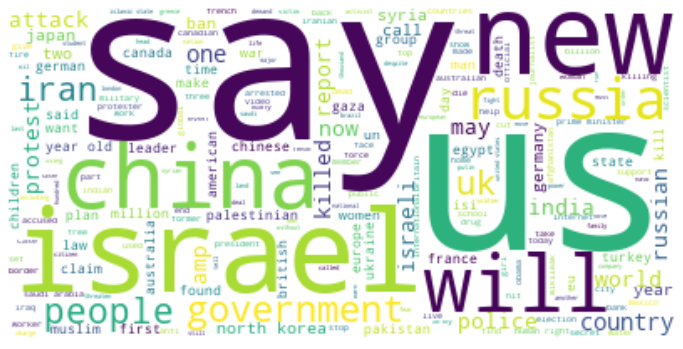

In [ ]:
#creating word clouds
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Generating the word cloud 
word_cloud_headlines = WordCloud(background_color="white").generate(comb_head)

# Create a figure of the generated cloud
plt.figure(figsize=(12,12))
plt.imshow(word_cloud_headlines, interpolation='bilinear')  
plt.axis('off')
# Display the figure
plt.show()

The above word cloud shows name of the countries which were newsmaker over these years. We see that Israel, US, China, and Russia are the top newmakers. We see some unwanted words like "say", "new", and "will" which are a few of the noise words. 



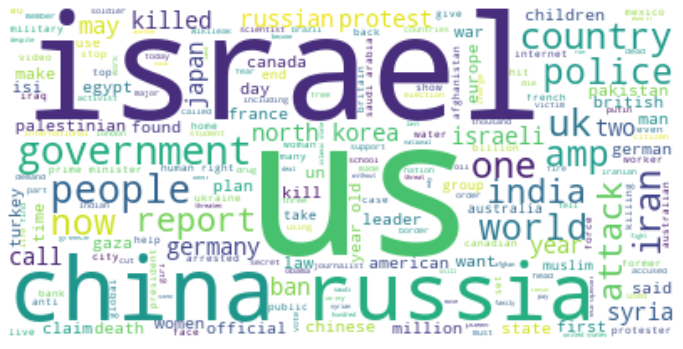

In [ ]:
from wordcloud import STOPWORDS
# Generating the word cloud 

stop_words = ['a','about','above','after','again','against','all','also','am','an','and','any','are',"aren't",'as','at','be','because','been','before','being','below','between','both','br','but','by','can',"can't",'cannot','com','could',"couldn't",'did',"didn't",'do','does',"doesn't",'doing',"don't",'down','during','each','else','ever','few','film','films','for','from','further','get','had',"hadn't",'has',"hasn't",'have',"haven't",'having','he',"he'd","he'll","he's",'her','here',"here's",'hers','herself','him','himself','his','how',"how's",'however','http','i',"i'd","i'll","i'm","i've",'if','in','into','is',"isn't",'it',"it's",'its','itself','just','k',"let's",'like','me','more','most','movie','movies',"mustn't",'my','myself','new','no','nor','not','of','off','on','once','only','or','other','otherwise','ought','our','ours','ourselves','out','over','own','r','same','say','says','shall',"shan't",'she',"she'd","she'll","she's",'should',"shouldn't",'since','so','some','such','than','that',"that's",'the','their','theirs','them','themselves','then','there',"there's",'these','they',"they'd","they'll","they're","they've",'this','those','through','to','too','under','until','up','very','was',"wasn't",'watch','we',"we'd","we'll","we're","we've",'were',"weren't",'what',"what's",'when',"when's",'where',"where's",'which','while','who',"who's",'whom','why',"why's",'will','with',"won't",'would',"wouldn't",'www','you',"you'd","you'll","you're","you've",'your','yours','yourself','yourselves'] + list(STOPWORDS)
cloud_head = WordCloud(background_color="white",stopwords=stop_words).generate(comb_head)

# Create a figure of the generated cloud
plt.figure(figsize=(12,12))
plt.imshow(cloud_head, interpolation='bilinear')  
plt.axis('off')
# Display the figure
plt.show()

The above figure shows word cloud after excluding stopwords which are random noise words and does not add value in sentiment analysis. Now words like “killed”, “world”, and “attack” are easily visible.

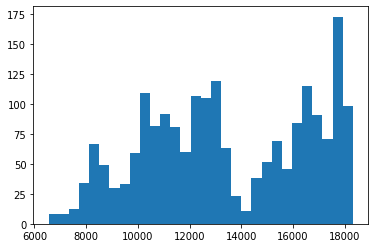

In [ ]:
#plotting the target variable
plt.hist(df1['Adj Close'],bins=30)
plt.show()

The above graph shows the distribution of the target variable that is the adjusted closing price. It is a multimodal distribution.

Text(0.5, 0, 'Years')

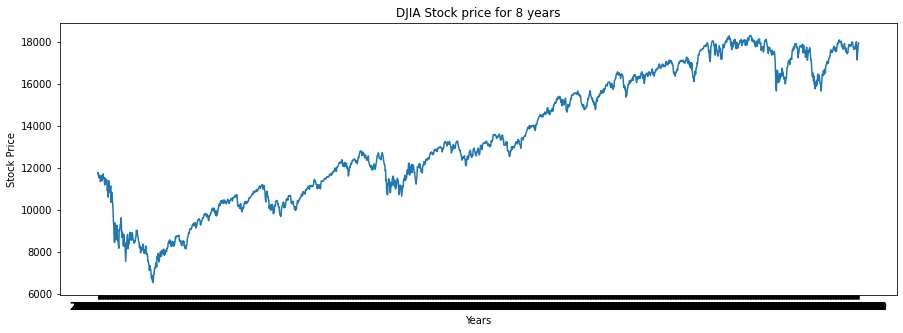

In [ ]:
df1.set_index('Date', inplace = True)
df1=df1.sort_index()
plt.figure(figsize=(15, 5))
plt.plot(df1.index,df1['Adj Close'])
plt.title("DJIA Stock price for 8 years")
plt.ylabel("Stock Price")
plt.xlabel("Years")


This show the trend of DJIA stocks over the years. It has a positive trend and seasonality as we can see some repeated patterns.

In [ ]:
#plt.figure(figsize=(10, 5))
#sns.countplot(ts2['emotion'])
#plt.title('Count Plot on Sentiment Variable')

NameError: ignored

<Figure size 720x360 with 0 Axes>

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer 

# Build the vectorizer, specify max features 
vect = CountVectorizer(max_features=100)
# Fit the vectorizer
vect.fit(clean_headlines)

# Transform the review column
X_review = vect.transform(clean_headlines)

# Create the bow representation
X_df = pd.DataFrame(X_review.toarray(), columns=vect.get_feature_names())
print(X_df.head())

   about  after  against  all  amp  an  ...  will  with  world  year  years  you
0      0      0        2    0    1   1  ...     3     2      2     1      1    1
1      1      0        0    0    0   2  ...     0     2      1     0      0    0
2      0      0        0    1    0   0  ...     0     1      1     2      0    3
3      0      0        3    1    0   2  ...     2     1      0     1      0    0
4      1      0        0    1    0   1  ...     1     0      2     0      1    1

[5 rows x 100 columns]


In [ ]:
from sklearn.feature_extraction.text import CountVectorizer 

# Build the vectorizer, specify token sequence and fit
vect = CountVectorizer(ngram_range=(1,2))
vect.fit(clean_headlines)

# Transform the review column
X_review = vect.transform(clean_headlines)

# Create the bow representation
X_df = pd.DataFrame(X_review.toarray(), columns=vect.get_feature_names())
print(X_df.head())

   aa  aa from  aa in  aa india  ...  zygi  zygi naval  zyklon  zyklon the
0   0        0      0         0  ...     0           0       0           0
1   0        0      0         0  ...     0           0       0           0
2   0        0      0         0  ...     0           0       0           0
3   0        0      0         0  ...     0           0       0           0
4   0        0      0         0  ...     0           0       0           0

[5 rows x 459034 columns]


In [ ]:
#Install text2emotion for extracting emotions


In [ ]:
#Extracting emotions
cln_headlines = []
for i in range (0,len(headlines)):
  cln_headlines.append(te.get_emotion(headlines[i]))
#cln_headlines.to_csv('cln_headlines.csv',index=False)
#cln_headlines

KeyboardInterrupt: ignored

In [ ]:
#import csv 
#file = open('cln_headlines.csv', 'w+', newline ='') 
#with file:     
    #write = csv.writer(file) 
    #write.writerows(cln_headlines) 

#with open('cln_headlines.txt', 'w') as f:
    #for item in cln_headlines:
        #f.write("%s\n" % item)

In [ ]:
cln_headlines

In [ ]:
#cln_headlines = {}
#for i in range (0,len(headlines)):
 # cln_headlines[i]=(te.get_emotion(headlines[i]))

In [ ]:
#cln_headlines

In [ ]:
emotions = []
score = []
for i in range (0,len(headlines)): 
  emotions.append(max(cln_headlines[i],key=cln_headlines[i].get))
  score.append(max(cln_headlines[i].values()))

emotions=pd.DataFrame({'emotion':emotions,'score':score})
#Saving result in csv
#emotions.to_csv('ts1.csv',index=False)



In [ ]:
#creating time series 
#ts2=df[['Date','Label']]
#ts2.to_csv('ts2.csv',index=False)

In [ ]:
#creating time series ts1 and ts2.
ts1=pd.read_csv('/content/ts1.csv',encoding = "ISO-8859-1")
ts2=pd.read_csv('/content/upload_DJIA_table.csv',encoding = "ISO-8859-1")
#ts2=pd.read_csv('/content/ts2.csv',encoding = "ISO-8859-1")
ts2=ts2[['Date','Adj Close']]
ts1=ts1[['emotion','score']].join(ts2[['Date']])




In [ ]:
ts2.set_index('Date', inplace = True)
ts2=ts2.sort_index()
ts2.info()
ts2.head()

<class 'pandas.core.frame.DataFrame'>
Index: 1989 entries, 2008-08-08 to 2016-07-01
Data columns (total 1 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Adj Close  1989 non-null   float64
dtypes: float64(1)
memory usage: 31.1+ KB


,Adj Close
Date,
2008-08-08,11734.320312
2008-08-11,11782.349609
2008-08-12,11642.469727
2008-08-13,11532.959961
2008-08-14,11615.929688


In [ ]:
ts1.set_index('Date', inplace = True)
ts1=ts1.sort_index()
ts1.info()
ts1.head()

<class 'pandas.core.frame.DataFrame'>
Index: 1989 entries, 2008-08-08 to 2016-07-01
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   emotion  1989 non-null   object 
 1   score    1989 non-null   float64
dtypes: float64(1), object(1)
memory usage: 46.6+ KB


,emotion,score
Date,,
2008-08-08,Fear,0.43
2008-08-11,Fear,0.48
2008-08-12,Fear,0.43
2008-08-13,Fear,0.36
2008-08-14,Surprise,0.33


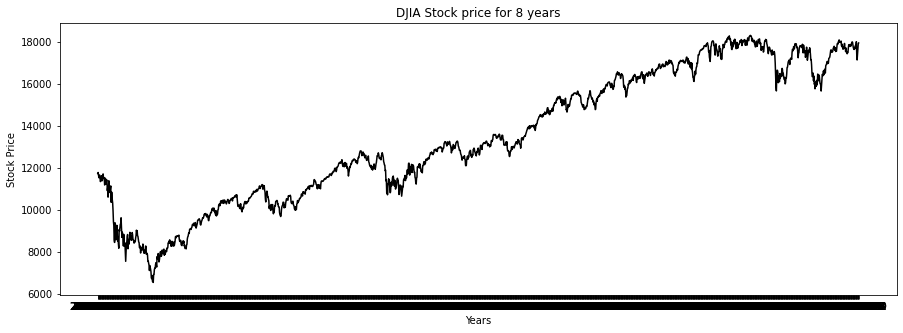

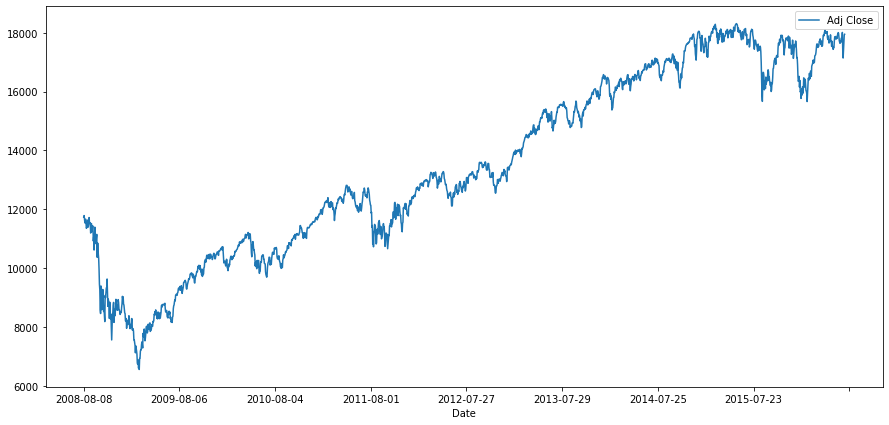

In [ ]:
plt.figure(figsize=(15, 5))
plt.plot(ts2.index, ts2['Adj Close'], color='black')
plt.title("DJIA Stock price for 8 years")
plt.ylabel("Stock Price")
plt.xlabel("Years")

from pylab import rcParams
rcParams['figure.figsize'] = 15, 7
ts2.plot()

In [ ]:
#plt.figure(figsize=(15, 5))
#plt.plot(ts1.index, ts1['score'], color='black')
#plt.title("DJIA Stock price for 8 years")
#plt.ylabel("Stock Price")
#plt.xlabel("Years")

#plt.plot(returns)
#score_pct=ts1['score'].pct_change()
#plt.plot(score_pct)
#returns.corr(score_pct)

#plt.figure(figsize=(10, 5))
#sns.countplot(ts1['emotion'])
#plt.title('Count Plot on Sentiment Variable')



In [ ]:
ts1['emotion'].value_counts()

Fear        1819
Surprise     135
Sad           35
Name: emotion, dtype: int64

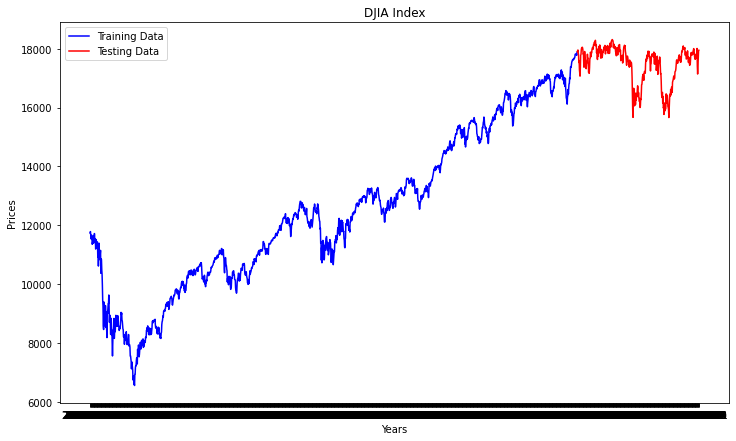

In [ ]:
#Splitting in 80:20 Ratio
train_data, test_data = ts2[0:int(len(ts2)*0.8)], ts2[int(len(ts2)*0.8):]
train_data= train_data.reset_index()
test_data= test_data.reset_index()
train_data = train_data.set_index('Date', drop= False)
test_data = test_data.set_index('Date', drop= False)
#train_data= train_data.reset_index()
#test_data= test_data.reset_index()

plt.figure(figsize=(12,7))
plt.title('DJIA Index')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.plot(train_data['Adj Close'], 'blue', label='Training Data')
plt.plot(test_data['Adj Close'], 'red', label='Testing Data')
plt.legend()

In [ ]:
#printing training and testing shape
print(f"Train Data Shape: {train_data.shape}")
print(f"Test Data Shape: {test_data.shape}")

Train Data Shape: (1591, 2)
Test Data Shape: (398, 2)


In [ ]:
#saving training and testing data in csv
train_data.to_csv('train.csv')
test_data.to_csv('test.csv')

Text(0.5, 0, 'Years')

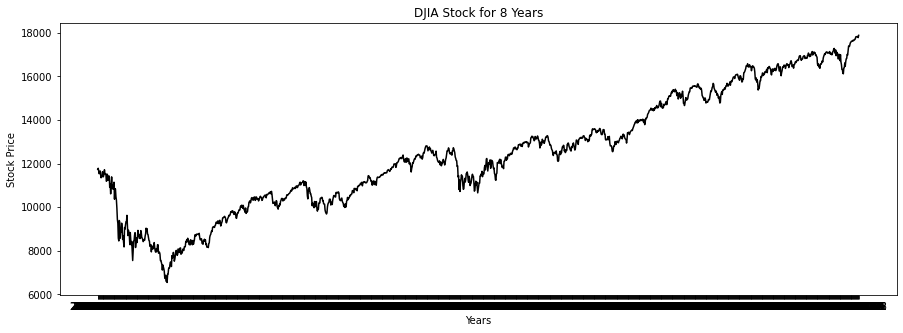

In [ ]:
#plotting training data
plt.figure(figsize=(15, 5))
plt.plot(train_data["Adj Close"], color='black')
plt.title("DJIA Stock for 8 Years")
plt.ylabel("Stock Price")
plt.xlabel("Years")

Checking stationarity of Time Series: There are three conditions to be met for a time series to be a stationary time series. These conditions are:

1. Constant mean
2. Constant variance
3. Autocovariance 

We will check the seasonality in time series.

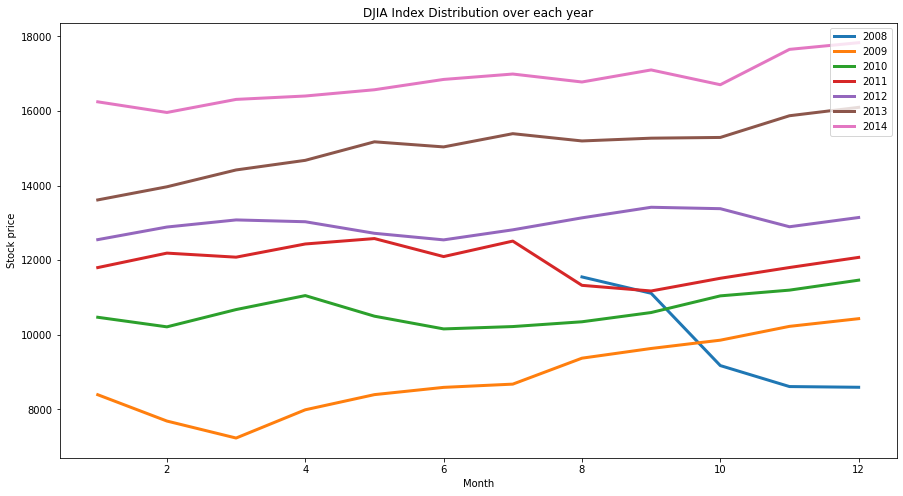

In [ ]:
season = train_data
season['Date'] = pd.to_datetime(season['Date'],errors='coerce')
season['Date'] = train_data.Date
season['Year'] = train_data.Date.dt.year
season['Month'] = train_data['Date'].dt.month
spivot = pd.pivot_table(season, index='Month', columns = 'Year', values = 'Adj Close')
spivot.plot(figsize=(15,8), linewidth=3)
plt.legend(loc = 'upper right')
plt.ylabel('Stock price')
plt.title('DJIA Index Distribution over each year')
plt.show()

The time series has little seasonality, we can see that stock prices fall around June (6th month) and it rises after June. The best months to sell the stocks seems between August to December as the series has a general upward trend.

Now we will check the stationarity of the time series. 

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


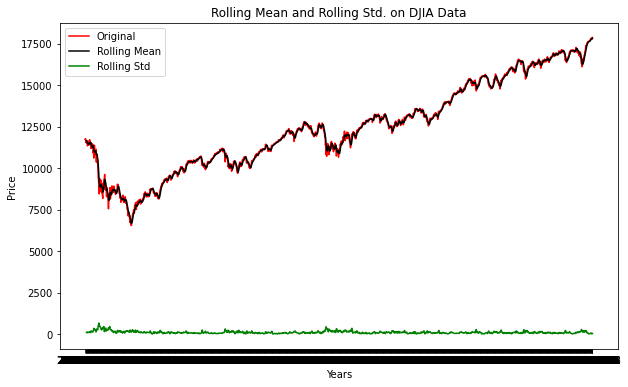

Test statistic:  0.49003049114940483
p-value:  0.9845669104126586
Critical Values: {'1%': -3.434524653155409, '5%': -2.863383859017768, '10%': -2.567751638185023}


In [ ]:
#Checking stationarity of time series

ts = train_data['Adj Close']
date = train_data['Date']

# adfuller library 
from statsmodels.tsa.stattools import adfuller

# check_adfuller
def check_adfuller(ts):

    # Dickey-Fuller test
    result = adfuller(ts, autolag='AIC')
    print('Test statistic: ' , result[0])
    print('p-value: '  ,result[1])
    print('Critical Values:' ,result[4])

# check_mean_std
def check_mean_std(ts):
    
    #Rolling statistics
    rolmean = ts.rolling(5).mean()
    rolstd = ts.rolling(5).std()
    plt.figure(figsize=(10,6))   
    orig = plt.plot(ts, color='red',label='Original')
    mean = plt.plot(rolmean, color='black', label='Rolling Mean')
    std = plt.plot(rolstd, color='green', label = 'Rolling Std')
    plt.xlabel("Years")
    plt.ylabel("Price")
    plt.title('Rolling Mean and Rolling Std. on DJIA Data')
    plt.legend()
    plt.show()
    
# check stationary: mean, variance(std) and adfuller test
check_mean_std(ts)
check_adfuller(ts)

The first criterian for stationarity that is constant mean is not satisfied as we can see the black line in the plot above. The second condition is met as the green line which shows variance, looks almost constant. The third criterian is if the test statistic is less than critical value we can say that the time series is constant. As shown in graph the test statistic is greater than the critical value (5%), hence the time series is not stationary.  

As the time series is not stationary, we can do some transformations to make the time series stationary. The folowing two methods are used to make the time series stationary.


*   Moving average method
*   Differencing method



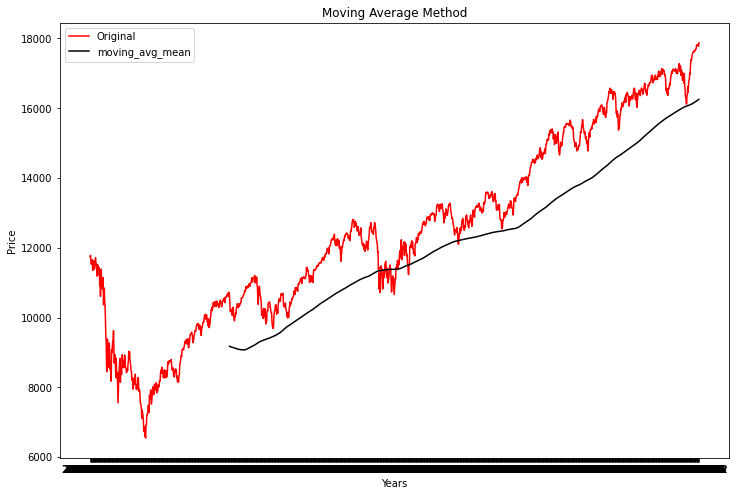

In [ ]:
# Moving average method
window_size = 365
moving_avg = ts.rolling(window_size).mean()
plt.figure(figsize=(12,8))
plt.plot(ts, color = "red",label = "Original")
plt.plot(moving_avg, color='black', label = "moving_avg_mean")
plt.title("Moving Average Method")
plt.xlabel("Years")
plt.ylabel("Price")
plt.legend()
plt.show()

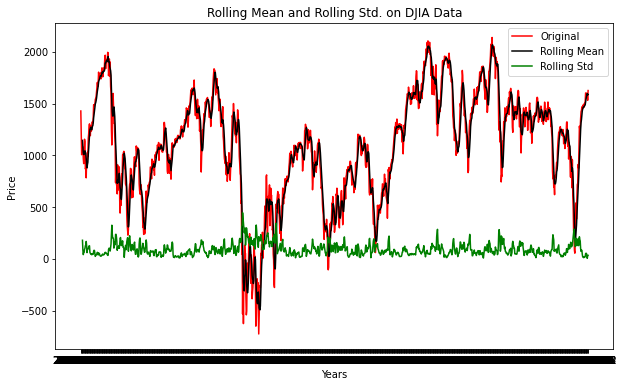

Test statistic:  -3.3944162341106088
p-value:  0.011150700990084177
Critical Values: {'1%': -3.435716995109265, '5%': -2.8639100200710828, '10%': -2.568031835031368}


In [ ]:
ts_moving_avg_diff = ts - moving_avg
ts_moving_avg_diff.dropna(inplace=True)

# check stationary: mean, variance(std)and adfuller test
check_mean_std(ts_moving_avg_diff)
check_adfuller(ts_moving_avg_diff)

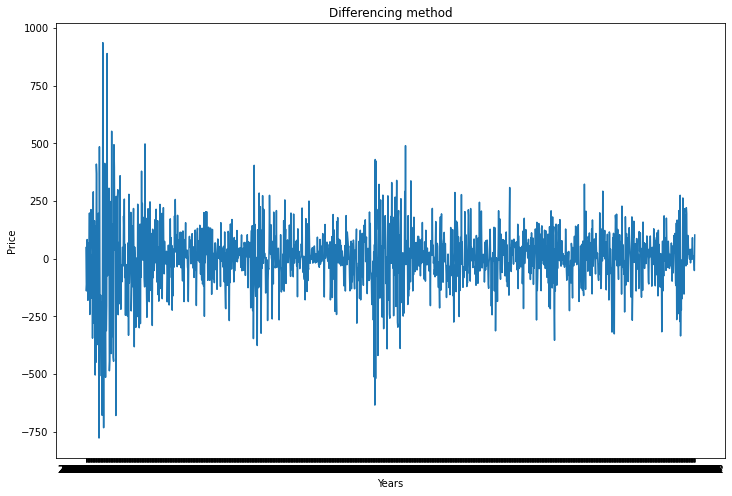

In [ ]:
# differencing method

#shifting by 1 period
ts_diff = ts - ts.shift(1)
plt.figure(figsize=(12,8))
plt.plot(ts_diff)
plt.title("Differencing method") 
plt.xlabel("Years")
plt.ylabel("Price")
plt.show()

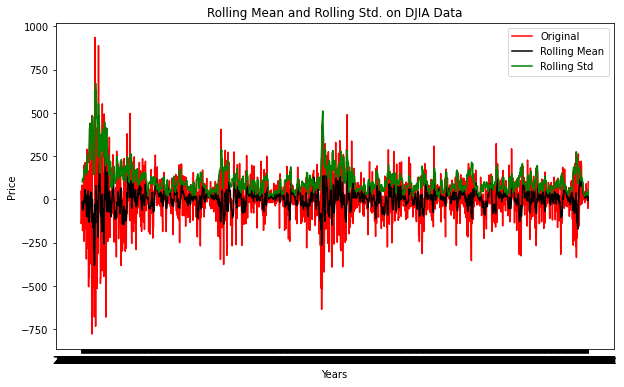

Test statistic:  -9.801321929051262
p-value:  5.984429922360262e-17
Critical Values: {'1%': -3.434524653155409, '5%': -2.863383859017768, '10%': -2.567751638185023}


In [ ]:
ts_diff.dropna(inplace=True) # due to shifting there is nan values
# check stationary: mean, variance(std)and adfuller test
check_mean_std(ts_diff)
check_adfuller(ts_diff)

In [ ]:
from statsmodels.tsa.stattools import acf, pacf

lag_acf = acf(ts_diff, nlags=20)
lag_pacf = pacf(ts_diff, nlags=20, method='ols')

#df['Sales First Difference'] = df['Sales'] - df['Sales'].shift(1)
#df['Seasonal First Difference']=df['Sales']-df['Sales'].shift(12)
#df.head()
#ts_diff = ts - ts.shift(12)
#from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
#import statsmodels.api as sm
#fig = plt.figure(figsize=(12,8))
#ax1 = fig.add_subplot(211)
#fig = sm.graphics.tsa.plot_acf(ts_diff.dropna(),lags=40,ax=ax1)
#ax2 = fig.add_subplot(212)
#fig = sm.graphics.tsa.plot_pacf(ts_diff.dropna(),lags=40,ax=ax2)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/stattools.py:541: FutureWarning: fft=True will become the default in a future version of statsmodels. To suppress this warning, explicitly set fft=False.
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Partial Autocorrelation Function')

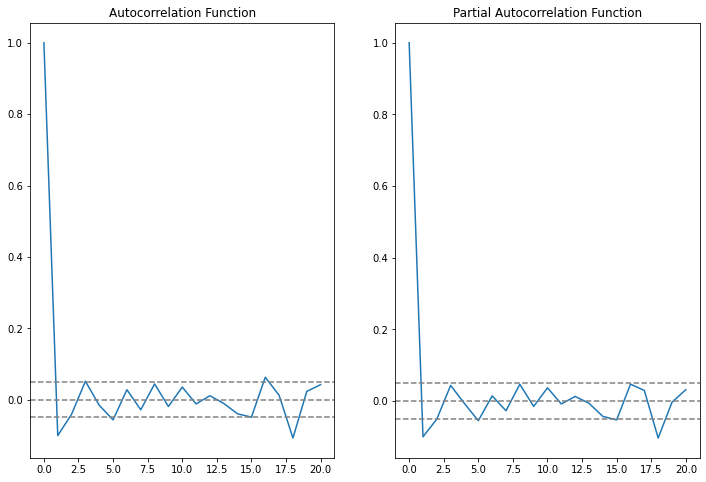

In [ ]:

plt.figure(figsize=(12,8))

#Plot ACF: 
plt.subplot(121) 
plt.plot(lag_acf)
plt.axhline(y=0,linestyle='--',color='gray')
plt.axhline(y=-1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.axhline(y=1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.title('Autocorrelation Function')

#Plot PACF:
plt.subplot(122)
plt.plot(lag_pacf)
plt.axhline(y=0,linestyle='--',color='gray')
plt.axhline(y=-1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.axhline(y=1.96/np.sqrt(len(ts_diff)),linestyle='--',color='gray')
plt.title('Partial Autocorrelation Function')

In [ ]:
#sm.graphics.tsa.plot_acf(ts_diff,lags=30)
#sm.graphics.tsa.plot_pacf(ts_diff,lags=30)
#plt.show()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:219: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:219: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)


                             ARIMA Model Results                              
Dep. Variable:            D.Adj Close   No. Observations:                 1590
Model:                 ARIMA(3, 1, 2)   Log Likelihood              -10060.418
Method:                       css-mle   S.D. of innovations            135.358
Date:                Sat, 18 Sep 2021   AIC                          20134.835
Time:                        20:46:57   BIC                          20172.436
Sample:                             1   HQIC                         20148.802
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 3.8645      3.075      1.257      0.209      -2.162       9.891
ar.L1.D.Adj Close    -0.8530      0.027    -32.098      0.000      -0.905      -0.801
ar.L2.D.Adj Close    -1.

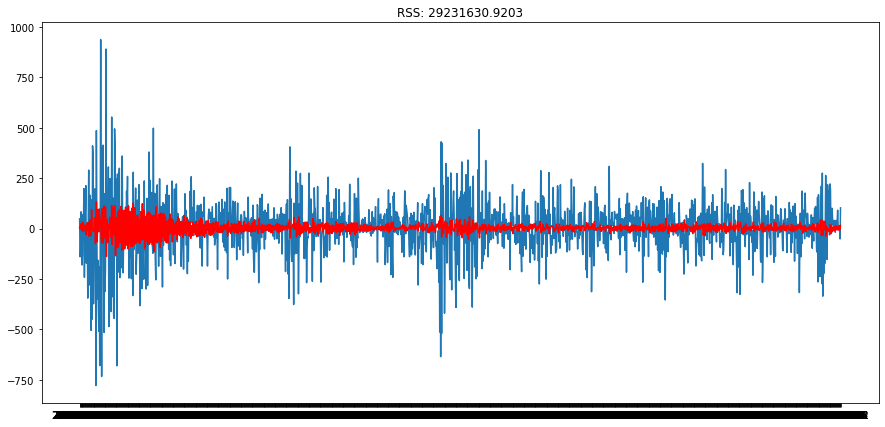

In [ ]:
from statsmodels.tsa.arima_model import ARIMA
plt.figure(figsize=(15,7))

model = ARIMA(ts, order=(3, 1, 2))  
results_ARIMA = model.fit(disp=-1)  
plt.plot(ts_diff)
plt.plot(results_ARIMA.fittedvalues, color='red')
plt.title('RSS: %.4f'% sum((results_ARIMA.fittedvalues-ts_diff)**2))

print(results_ARIMA.summary())

In [ ]:
yhat = results_ARIMA.predict(1, 1591)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:576: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  ValueWarning)


In [ ]:
yhat.head()

0     3.864469
1    -0.814749
2    17.801691
3    23.642109
4    -4.809449
dtype: float64

In [ ]:
predictions_ARIMA_diff_cumsum = yhat.cumsum() + train_data['Adj Close'][0]
print (predictions_ARIMA_diff_cumsum.head())
print (predictions_ARIMA_diff_cumsum.tail())

0    11738.184781
1    11737.370033
2    11755.171724
3    11778.813832
4    11774.004383
dtype: float64
1586    17903.072148
1587    17907.666387
1588    17901.257569
1589    17916.956802
1590    17917.611661
dtype: float64


RMSE_ARIMA = 2898.4944475281395


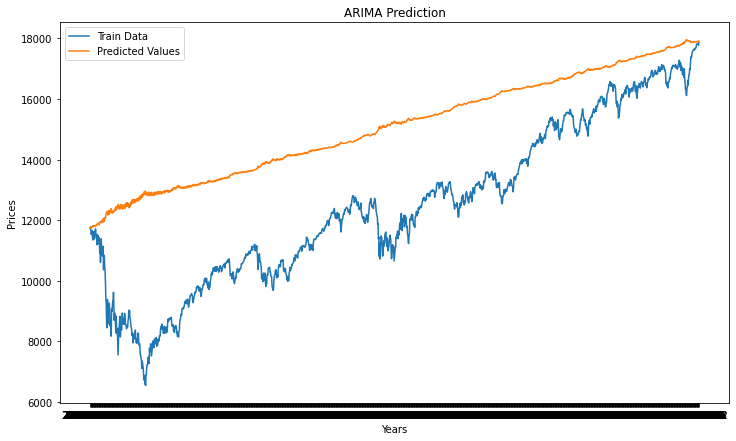

In [ ]:
#Predicting Train Data
from sklearn.metrics import mean_squared_error
from math import sqrt

predictions = pd.DataFrame(predictions_ARIMA_diff_cumsum.values)
predictions.set_index(train_data.index, inplace = True)

plt.figure(figsize=(12,7))

plt.plot(train_data['Adj Close'], label = 'Train Data')
plt.plot(predictions, label = 'Predicted Values')
plt.title('ARIMA Prediction')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.legend()

RMSE_ARIMA = sqrt(mean_squared_error(train_data['Adj Close'].values, predictions_ARIMA_diff_cumsum.values))

print(f"RMSE_ARIMA = {RMSE_ARIMA}")

In [ ]:
len(train_data), len(test_data)

(1591, 398)

In [ ]:
yhat = results_ARIMA.predict(1591, 1591+397,dynamic=True)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:576: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  ValueWarning)


In [ ]:
yhat.head()

1590     0.654859
1591    -8.345670
1592     7.950682
1593    13.774240
1594    -7.759288
dtype: float64

In [ ]:
predictions_ARIMA_diff_cumsum = yhat.cumsum() + train_data['Adj Close'][-1]
print (predictions_ARIMA_diff_cumsum.head())
print (predictions_ARIMA_diff_cumsum.tail())

1590    17880.205640
1591    17871.859970
1592    17879.810652
1593    17893.584891
1594    17885.825603
dtype: float64
1983    19389.263456
1984    19399.348675
1985    19402.342566
1986    19400.665165
1987    19409.574889
dtype: float64


RMSE_ARIMA = 1442.721343585631


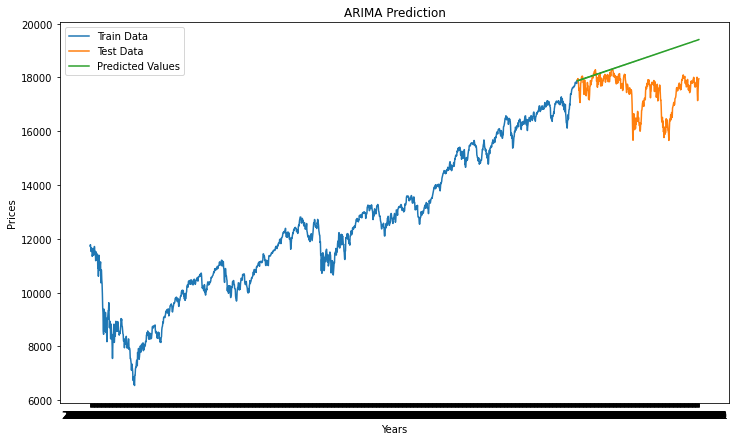

In [ ]:

from sklearn.metrics import mean_squared_error
from math import sqrt

predictions = pd.DataFrame(predictions_ARIMA_diff_cumsum.values)
predictions.set_index(test_data.index, inplace = True)

plt.figure(figsize=(12,7))

plt.plot(train_data['Adj Close'], label = 'Train Data')
plt.plot(test_data['Adj Close'], label = 'Test Data')
plt.plot(predictions, label = 'Predicted Values')
plt.title('ARIMA Prediction')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.legend()

RMSE_ARIMA = sqrt(mean_squared_error(test_data['Adj Close'].values, predictions_ARIMA_diff_cumsum.values))

print(f"RMSE_ARIMA = {RMSE_ARIMA}")

In [ ]:
#!pip install pmdarima
#from pmdarima import auto_arima
#import warnings
#warnings.filterwarnings("ignore")
#stepwise_fit = auto_arima(ts,trace=True)
#stepwise_fit.summary()

ModuleNotFoundError: ignored

2.SARIMAX

In [ ]:
import statsmodels.api as sm

In [ ]:
model = sm.tsa.statespace.SARIMAX(ts_diff, order=(5, 0, 1), seasonal_order=(0,0,0,0))
results_SARIMAX = model.fit()

print(results_SARIMAX.summary())

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:219: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)


                           Statespace Model Results                           
Dep. Variable:              Adj Close   No. Observations:                 1590
Model:               SARIMAX(5, 0, 1)   Log Likelihood              -10064.040
Date:                Sat, 18 Sep 2021   AIC                          20142.079
Time:                        20:48:27   BIC                          20179.679
Sample:                             0   HQIC                         20156.046
                               - 1590                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9240      0.068    -13.581      0.000      -1.057      -0.791
ar.L2         -0.1270      0.022     -5.693      0.000      -0.171      -0.083
ar.L3          0.0044      0.021      0.208      0.8

In [ ]:
len(train_data), len(test_data)

(1591, 398)

In [ ]:
yhat = results_SARIMAX.predict(1591, 1591+397, dynamic=True)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:576: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  ValueWarning)
/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/kalman_filter.py:1960: ValueWarning: Dynamic prediction specified to begin during out-of-sample forecasting period, and so has no effect.
  ' effect.', ValueWarning)


In [ ]:
yhat.head()

1591   -5.580891
1592    5.444481
1593    0.773300
1594   -6.776002
1595    6.496171
dtype: float64

In [ ]:
predictions_SARIMAX_diff_cumsum = yhat.cumsum() + train_data['Adj Close'][-1]
print (predictions_SARIMAX_diff_cumsum.head())
print (predictions_SARIMAX_diff_cumsum.tail())

1591    17873.969890
1592    17879.414371
1593    17880.187671
1594    17873.411669
1595    17879.907840
dtype: float64
1984    17877.091433
1985    17877.091433
1986    17877.091433
1987    17877.091433
1988    17877.091433
dtype: float64


In [ ]:
yhat

1591   -5.580891e+00
1592    5.444481e+00
1593    7.733002e-01
1594   -6.776002e+00
1595    6.496171e+00
            ...     
1984   -1.067350e-19
1985    9.504316e-20
1986   -8.463208e-20
1987    7.536144e-20
1988   -6.710630e-20
Length: 398, dtype: float64

RMSE_SARIMAX = 732.9779411393856


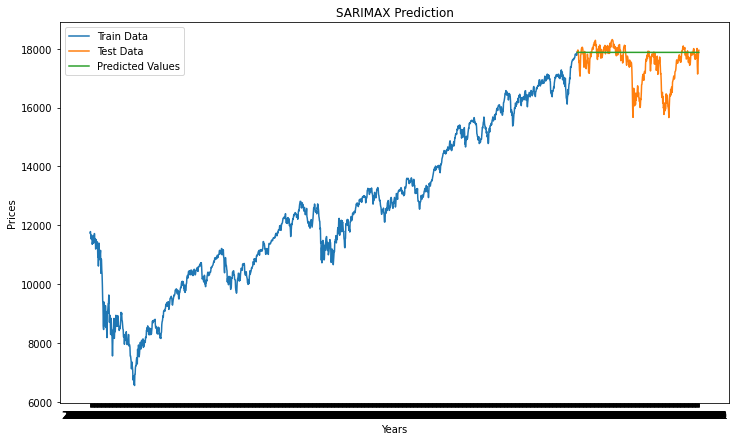

In [ ]:
predictions = pd.DataFrame(predictions_SARIMAX_diff_cumsum)
predictions.set_index(test_data.index, inplace = True)

plt.figure(figsize=(12,7))

plt.plot(train_data['Adj Close'], label = 'Train Data')
plt.plot(test_data['Adj Close'], label = 'Test Data')
plt.plot(predictions, label = 'Predicted Values')
plt.title('SARIMAX Prediction')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.legend()

RMSE_SARIMAX = sqrt(mean_squared_error(test_data['Adj Close'].values, predictions_SARIMAX_diff_cumsum))

print(f"RMSE_SARIMAX = {RMSE_SARIMAX}")

In [ ]:
#ts1=ts1.reset_index()
#ts1['Date'] = pd.to_datetime(ts1['Date'],errors='coerce')
#ts1['Date'] = ts1['Date'].dt.date
#ts1.set_index('Date', inplace = True)
#plt.figure(figsize=(20, 5))
#plt.plot(ts1['Date'],ts1['emotion'])
#plt.xlabel('Years')
#plt.ylabel('Emotion')

3.LSTM

In [ ]:
from tensorflow import keras

from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from keras.callbacks import EarlyStopping

from tensorflow.keras import backend as K

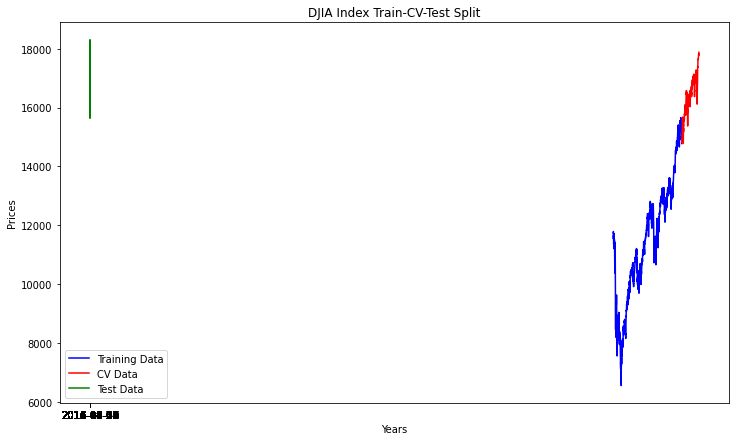

In [ ]:
#Splitting the data in Train-CV-Test in the ratio 64:16:20
X_train, X_cv = train_data[0:int(len(train_data)*0.8)], train_data[int(len(train_data)*0.8):]

X_train = X_train.set_index('Date', drop= False)
X_cv = X_cv.set_index('Date', drop= False)

plt.figure(figsize=(12,7))
plt.title('DJIA Index Train-CV-Test Split')
plt.xlabel('Years')
plt.ylabel('Prices')
plt.plot(X_train['Adj Close'], 'blue', label='Training Data')
plt.plot(X_cv['Adj Close'], 'red', label='CV Data')
plt.plot(test_data['Adj Close'], 'green', label='Test Data')
plt.legend()


In [ ]:
len(X_train)

1272

In [ ]:
def create_dataset(dataset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back-1):
		a = dataset[i:(i+look_back), 0]
		dataX.append(a)
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)

In [ ]:
# Feature Scaling
sc = MinMaxScaler()
training_set_scaled = sc.fit_transform(X_train['Adj Close'].values.reshape(-1, 1))
cv_set_scaled = sc.transform(X_cv['Adj Close'].values.reshape(-1, 1))
test_set_scaled = sc.transform(test_data['Adj Close'].values.reshape(-1, 1))

In [ ]:
#Creating Dataset with Window Size 30.

trainX, trainY = create_dataset(training_set_scaled, 30)
cvX, cvY = create_dataset(cv_set_scaled, 30)
testX, testY = create_dataset(test_set_scaled, 30)

In [ ]:
trainX.shape, cvX.shape, testX.shape

((1241, 30), (288, 30), (367, 30))

In [ ]:
#Reshaping all the data
trainX, trainY = np.array(trainX), np.array(trainY)
trainX = np.reshape(trainX, (trainX.shape[0], trainX.shape[1], 1))

cvX, cvY = np.array(cvX), np.array(cvY)
cvX = np.reshape(cvX, (cvX.shape[0], cvX.shape[1], 1))

testX, testY = np.array(testX), np.array(testY)
testX = np.reshape(testX, (testX.shape[0], testX.shape[1], 1))

In [ ]:
#Defining our metric
def root_mean_squared_error(y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

In [ ]:
import tensorflow as tf 
from tensorflow import keras
from keras.callbacks import TensorBoard

!rm -rf ./logs/
keras.backend.clear_session()
%load_ext tensorboard

model = Sequential()

# Adding the input layer
model.add(LSTM(units=48, activation='tanh', kernel_initializer=tf.keras.initializers.glorot_uniform(seed=26), input_shape = (X_train.shape[1], 1)))

# Adding the output layer
model.add(Dense(1, name="output_layer"))

# Compiling the RNN
model.compile(optimizer = keras.optimizers.Adam(learning_rate=0.001), loss = root_mean_squared_error)

#Using Tensorboard
logdir = "logs"
tensorboard_callback = TensorBoard(log_dir=logdir, histogram_freq=5, write_graph=True)

# Fitting the RNN to the Training set
model.fit(trainX, trainY, epochs = 50, batch_size = 16,  validation_data = (cvX, cvY), callbacks = [tensorboard_callback])

Epoch 1/50
78/78 [==============================] - 4s 22ms/step - loss: 0.0977 - val_loss: 0.0384
Epoch 2/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0315 - val_loss: 0.0391
Epoch 3/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0297 - val_loss: 0.0284
Epoch 4/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0260 - val_loss: 0.0210
Epoch 5/50
78/78 [==============================] - 1s 13ms/step - loss: 0.0246 - val_loss: 0.0323
Epoch 6/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0233 - val_loss: 0.0187
Epoch 7/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0231 - val_loss: 0.0214
Epoch 8/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0220 - val_loss: 0.0264
Epoch 9/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0218 - val_loss: 0.0173
Epoch 10/50
78/78 [==============================] - 1s 14ms/step - loss: 0.0208 - val_loss: 0.0190
Epoch 11/

In [ ]:
%tensorboard --logdir logs/

<IPython.core.display.Javascript object>

In [ ]:
#Predicting on test data
predicted_stock_price = model.predict(testX)
predicted_stock_price = sc.inverse_transform(predicted_stock_price)

In [ ]:
#Changing datatype of date column from string to datetime

train_data['Date'] = pd.to_datetime(train_data['Date'])
test_data['Date'] = pd.to_datetime(test_data['Date'])

train_data['Date'] = train_data['Date'].dt.date
test_data['Date'] = test_data['Date'].dt.date

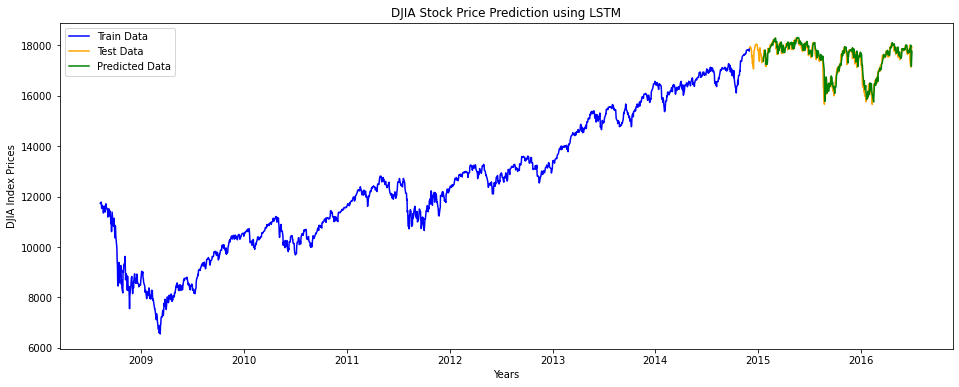

RMSE_LSTM = 230.64624947675424


In [ ]:
# Visualising the results
plt.figure(figsize=(16, 6))
plt.plot(train_data['Date'], train_data['Adj Close'], color = 'blue', label = 'Train Data')
plt.plot(test_data['Date'], test_data['Adj Close'].values, color = 'orange', label = 'Test Data')
plt.plot(test_data.iloc[31:]['Date'], predicted_stock_price, color = 'green', label = 'Predicted Data')
plt.title('DJIA Stock Price Prediction using LSTM')
plt.xlabel('Years')
plt.ylabel('DJIA Index Prices')
plt.legend()
plt.show()
from math import sqrt

RMSE_LSTM = sqrt(mean_squared_error(test_data.iloc[31:]['Adj Close'].values, predicted_stock_price))

print(f"RMSE_LSTM = {RMSE_LSTM}")

4.LSTM with news

In [ ]:
ts2=ts2.reset_index()
ts2.head()

,Date,Adj Close
0,2008-08-08,11734.320312
1,2008-08-11,11782.349609
2,2008-08-12,11642.469727
3,2008-08-13,11532.959961
4,2008-08-14,11615.929688


In [ ]:
ts1.head()

,emotion,score
Date,,
2008-08-08,Fear,0.43
2008-08-11,Fear,0.48
2008-08-12,Fear,0.43
2008-08-13,Fear,0.36
2008-08-14,Surprise,0.33


In [ ]:

data = pd.merge(ts1, ts2, on = 'Date')
data

,Date,emotion,score,Adj Close
0,2008-08-08,Fear,0.43,11734.320312
1,2008-08-11,Fear,0.48,11782.349609
2,2008-08-12,Fear,0.43,11642.469727
3,2008-08-13,Fear,0.36,11532.959961
4,2008-08-14,Surprise,0.33,11615.929688
...,...,...,...,...
1984,2016-06-27,Fear,0.47,17140.240234
1985,2016-06-28,Fear,0.56,17409.720703
1986,2016-06-29,Fear,0.33,17694.679688
1987,2016-06-30,Surprise,0.32,17929.990234


In [ ]:
#Splitting the  stock data in Train-CV-Test in the ratio 64:16:20

train_data, test_data = data[0:int(len(data)*0.8)], data[int(len(data)*0.8):]
train_data.reset_index()
test_data.reset_index()
train_data = train_data.set_index('Date', drop= False)
test_data = test_data.set_index('Date', drop= False)

In [ ]:
X_train, X_cv = train_data[0:int(len(train_data)*0.8)], train_data[int(len(train_data)*0.8):]

X_train = X_train.set_index('Date', drop= False)
X_cv = X_cv.set_index('Date', drop= False)

In [ ]:
len(X_train)

1272

In [ ]:
len(X_cv), len(test_data)

(319, 398)

In [ ]:
def create_dataset(dataset, scoreset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back-1):
		a = dataset[i:(i+look_back), 0]
		b = scoreset[i+look_back-1]
		dataX.append(np.append(a,b))
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)

In [ ]:
# Feature Scaling
sc = MinMaxScaler()
training_set_scaled = sc.fit_transform(X_train['Adj Close'].values.reshape(-1, 1))
cv_set_scaled = sc.transform(X_cv['Adj Close'].values.reshape(-1, 1))
test_set_scaled = sc.transform(test_data['Adj Close'].values.reshape(-1, 1))

sc1 = MinMaxScaler()
training_score_scaled = sc1.fit_transform(X_train['score'].values.reshape(-1, 1))
cv_score_scaled = sc1.transform(X_cv['score'].values.reshape(-1, 1))
test_score_scaled = sc1.transform(test_data['score'].values.reshape(-1, 1))

In [ ]:
#Creating Dataset with window size = 60 + News Sentiment of Last Day

trainX, trainY = create_dataset(training_set_scaled, training_score_scaled, 60)
cvX, cvY = create_dataset(cv_set_scaled, cv_score_scaled, 60)
testX, testY = create_dataset(test_set_scaled, test_score_scaled, 60)

In [ ]:
trainX.shape, cvX.shape, testX.shape

((1211, 61), (258, 61), (337, 61))

In [ ]:
#Reshaping all data.

trainX, trainY = np.array(trainX), np.array(trainY)
trainX = np.reshape(trainX, (trainX.shape[0], trainX.shape[1], 1))

cvX, cvY = np.array(cvX), np.array(cvY)
cvX = np.reshape(cvX, (cvX.shape[0], cvX.shape[1], 1))

testX, testY = np.array(testX), np.array(testY)
testX = np.reshape(testX, (testX.shape[0], testX.shape[1], 1))

In [ ]:
import tensorflow as tf 
from tensorflow import keras
from keras.callbacks import TensorBoard

!rm -rf ./logs/
keras.backend.clear_session()
%load_ext tensorboard

model = Sequential()

# Adding the input layer
model.add(LSTM(units=128, activation='tanh', kernel_initializer=tf.keras.initializers.glorot_uniform(seed=26), input_shape = (trainX.shape[1], 1), unroll = True))

# Adding the output layer
model.add(Dense(1, name="output_layer"))

# Compiling the RNN
model.compile(optimizer = keras.optimizers.Adam(learning_rate=0.01), loss = root_mean_squared_error)

#Using Tensorboard
logdir = "logs"
tensorboard_callback = TensorBoard(log_dir=logdir, histogram_freq=5, write_graph=True)

# Fitting the RNN to the Training set
model.fit(trainX, trainY, epochs = 30, batch_size = 64,  validation_data = (cvX, cvY), callbacks = [tensorboard_callback])

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
Epoch 1/30
19/19 [==============================] - 12s 189ms/step - loss: 0.3198 - val_loss: 0.4069
Epoch 2/30
19/19 [==============================] - 2s 84ms/step - loss: 0.1065 - val_loss: 0.1780
Epoch 3/30
19/19 [==============================] - 2s 84ms/step - loss: 0.0587 - val_loss: 0.0644
Epoch 4/30
19/19 [==============================] - 2s 84ms/step - loss: 0.0324 - val_loss: 0.0320
Epoch 5/30
19/19 [==============================] - 2s 85ms/step - loss: 0.0266 - val_loss: 0.0205
Epoch 6/30
19/19 [==============================] - 2s 86ms/step - loss: 0.0199 - val_loss: 0.0216
Epoch 7/30
19/19 [==============================] - 2s 88ms/step - loss: 0.0197 - val_loss: 0.0390
Epoch 8/30
19/19 [==============================] - 2s 88ms/step - loss: 0.0230 - val_loss: 0.0362
Epoch 9/30
19/19 [==============================] - 2s 87ms/step - loss: 0.0186 - val_loss: 0.0212
Epoch 10/30
19/19

In [ ]:
%tensorboard --logdir logs/

Reusing TensorBoard on port 6006 (pid 490), started 0:01:03 ago. (Use '!kill 490' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
#Predicting on test data
predicted_stock_price = model.predict(testX)
predicted_stock_price = sc.inverse_transform(predicted_stock_price)

In [ ]:
#Changing datatype of date column from string to datetime

train_data['Date'] = pd.to_datetime(train_data['Date'])
test_data['Date'] = pd.to_datetime(test_data['Date'])

train_data['Date'] = train_data['Date'].dt.date
test_data['Date'] = test_data['Date'].dt.date

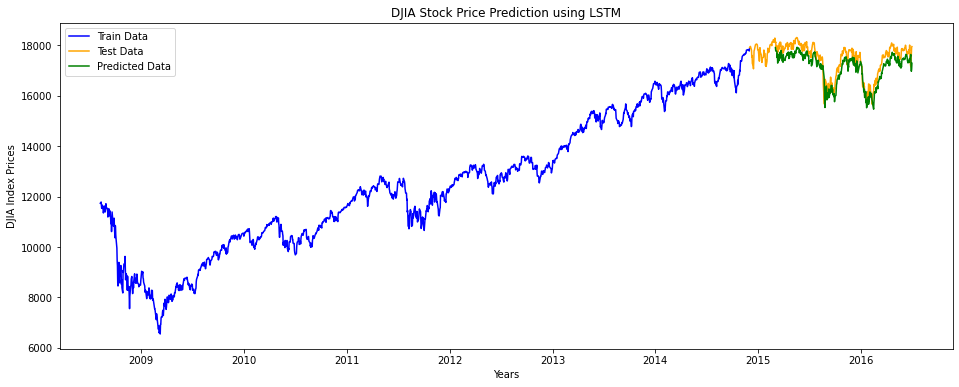

RMSE_LSTM = 398.0527738423199


In [ ]:
# Visualising the results
plt.figure(figsize=(16, 6))
plt.plot(train_data['Date'], train_data['Adj Close'], color = 'blue', label = 'Train Data')
plt.plot(test_data['Date'], test_data['Adj Close'].values, color = 'orange', label = 'Test Data')
plt.plot(test_data.iloc[61:]['Date'], predicted_stock_price, color = 'green', label = 'Predicted Data')
plt.title('DJIA Stock Price Prediction using LSTM')
plt.xlabel('Years')
plt.ylabel('DJIA Index Prices')
plt.legend()
plt.show()
from math import sqrt

RMSE_LSTM = sqrt(mean_squared_error(test_data.iloc[61:]['Adj Close'].values, predicted_stock_price))

print(f"RMSE_LSTM = {RMSE_LSTM}")

In [ ]:
from prettytable import PrettyTable
    
x = PrettyTable()

x.field_names = ["Model", "RMSE on Test Data"]

x.add_row(["ARIMA", 1440.34])
x.add_row(["SARIMAX", 2065.83])
x.add_row(["LSTM", 267.14])
x.add_row(["LSTM with News Sentiments", 265.67])

print(x)

+---------------------------+-------------------+
|           Model           | RMSE on Test Data |
+---------------------------+-------------------+
|           ARIMA           |      1440.34      |
|          SARIMAX          |      2065.83      |
|            LSTM           |       267.14      |
| LSTM with News Sentiments |       265.67      |
+---------------------------+-------------------+


In [ ]:
returns = MSFT.pct_change()

# Compute and print the autocorrelation of returns
autocorrelation = returns['Adj Close'].autocorr()
print("The autocorrelation of weekly returns is %4.2f" %(autocorrelation))

NameError: ignored

In [ ]:

emotions.isna().sum()

In [ ]:
#listOfElems = ['Hello', 'Ok', 'is', 'Ok', 'test', 'this', 'is', 'a', 'test']
result = checkIfDuplicates_2(clean_headlines)
if result:
    print('Yes, list contains duplicates')
else:
    print('No duplicates found in list') 

In [ ]:
#df['Date']
#ts1=pd.merge(emotions,df[['Date']],left_index=True, right_index=True)
ts1.to_csv('ts1.csv',index=True)
#ts2=df[['Date','Label']]
#ts2.to_csv('ts2.csv',index=True)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10, 5))
sns.countplot(cln_hdln_df['sentiment'])
plt.title('Count Plot on Sentiment Variable')

In [ ]:
cln_hdln_df

In [ ]:
#Adding some new words to Vader Dictionary to judge stock market news better.
from tqdm import tqdm

new_words =  {'falls': -9, 'drops': -9, 'slump' : -9, 'rise': 9, 'increases': 9, 'gain': 9, 'hiked': -9, 'dips': -9, 'declines': -9, 'decline': -9, 'hikes': -9, 'jumps': 9,
              'lose': -9, 'profit': 9, 'loss': -9, 'shreds': -9, 'sell': -9, 'buy': 9, 'recession': -9, 'record low': -9, 'record high': 9} 

analyser = SentimentIntensityAnalyzer()
analyser.lexicon.update(new_words)

for i in tqdm(cln_hdln_df.itertuples()):
    sent_score = analyser.polarity_scores(cln_hdln_df.iloc[i[0]]['headlines'])

    cln_hdln_df.at[i[0], 'sent_score'] = score['compound']

    if sent_score['compound'] >= 0:
        cln_hdln_df.at[i[0], 'sentiment'] = 1
    else:
        cln_hdln_df.at[i[0], 'sentiment'] = -1

In [ ]:
cln_hdln_df.head()

In [ ]:
cln_hdln_df.sentiment.value_counts()

In [ ]:
#Checking missing data
cln_hdln_df.isna().sum()

In [ ]:
#Checking Duplicated rows
cln_hdln_df.duplicated().sum()

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=200000,
        max_font_size=40, 
        scale=3).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

print("Word Cloud for Positive Headlines")
show_wordcloud(cln_hdln_df[cln_hdln_df['sentiment'] == 1].values)
print("\nWord Cloud for Negative Headlines")
show_wordcloud(cln_hdln_df[cln_hdln_df['sentiment'] == -1].values)

In [ ]:
plt.figure(figsize=(10, 7))
sns.distplot(cln_hdln_df['score'])
plt.ylabel('Probability')
plt.title('Probability Distribution of Sentiment Scores by VADER')

In [ ]:
cln_hdln_df.info()